# Wavefunction Representations!
Refer to http://hyperphysics.phy-astr.gsu.edu/hbase/quantum/hydwf.html for formulae, http://hyperphysics.phy-astr.gsu.edu/hbase/quantum/hydsch.html#c2 for derivations.

In [18]:
import numpy as np
import math
np.math = math
import matplotlib.pyplot as plt
from scipy.special import sph_harm, genlaguerre
from scipy.constants import physical_constants
import plotly.graph_objects as go

a0 = physical_constants['Bohr radius'][0]

In [19]:
# Radial hydrogen wavefunction
def R_nlm(n, l, r):
    rho = 2 * r / (n * a0)
    # Associated Laguerre polynomial
    L = genlaguerre(n-l-1, 2*l+1)(rho)

    # Normalization constant
    num = 2.0 / (n**2 * a0)
    pref = num**1.5 * np.sqrt(np.math.factorial(n-l-1) / (2*n*np.math.factorial(n+l)))

    return pref * np.exp(-rho/2) * rho**l * L


# Angular part (Y_l^m)
# represents the angular component of the wavefunction in terms of theta and phi
def Y_lm(l, m, theta, phi):
    return sph_harm(m, l, phi, theta)


# Full separated wavefunction ψ = R(r) Y(θ,φ)
def psi_nlm(n, l, m, r, theta, phi):
    return R_nlm(n,l,r) * Y_lm(l,m,theta,phi)

/var/folders/g1/x2bh3txd26n3xd5wj0ydblq40000gn/T/ipykernel_98580/3287716143.py:16: DeprecationWarning:

`scipy.special.sph_harm` is deprecated as of SciPy 1.15.0 and will be removed in SciPy 1.17.0. Please use `scipy.special.sph_harm_y` instead.



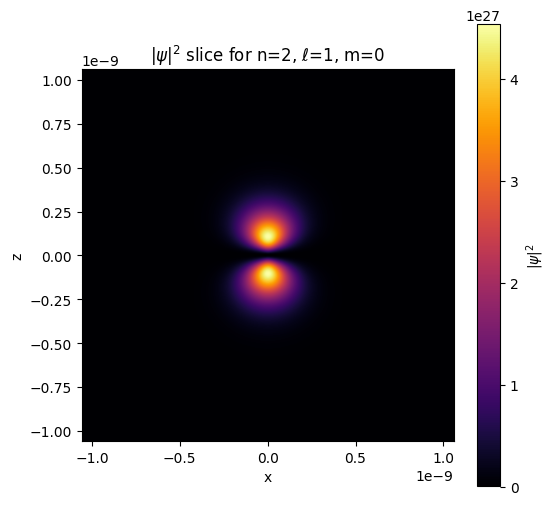

In [20]:
def plot_slice(n, l, m, plane_size=20*a0, N=400): #TODO: normalize to same scale, so that s orbitals look different, play with color maps to heart's content
    x = np.linspace(-plane_size, plane_size, N)
    z = np.linspace(-plane_size, plane_size, N)
    xx, zz = np.meshgrid(x, z)
    yy = 0  # slice at y = 0
    # TODO: swap to spherical

    # Convert to spherical
    r = np.sqrt(xx**2 + yy**2 + zz**2)
    theta = np.arccos(np.divide(zz, r, out=np.zeros_like(r), where=r!=0))
    phi = np.arctan2(yy, xx)

    psi_vals = psi_nlm(n,l,m, r, theta, phi)
    prob = np.abs(psi_vals)**2
    # TODO: explain why the squaring is happening

    plt.figure(figsize=(6,6))
    plt.imshow(prob, extent=[x.min(), x.max(), z.min(), z.max()],
               origin='lower', cmap='inferno')
    plt.title(fr"$|\psi|^2$ slice for n={n}, $\ell$={l}, m={m}")
    plt.xlabel("x")
    plt.ylabel("z")
    plt.colorbar(label=r"$|\psi|^2$")
    plt.show()

# Example: Hydrogen 2p (n=2, l=1, m=0)
plot_slice(2,1,0)

/var/folders/g1/x2bh3txd26n3xd5wj0ydblq40000gn/T/ipykernel_98580/3287716143.py:16: DeprecationWarning:

`scipy.special.sph_harm` is deprecated as of SciPy 1.15.0 and will be removed in SciPy 1.17.0. Please use `scipy.special.sph_harm_y` instead.



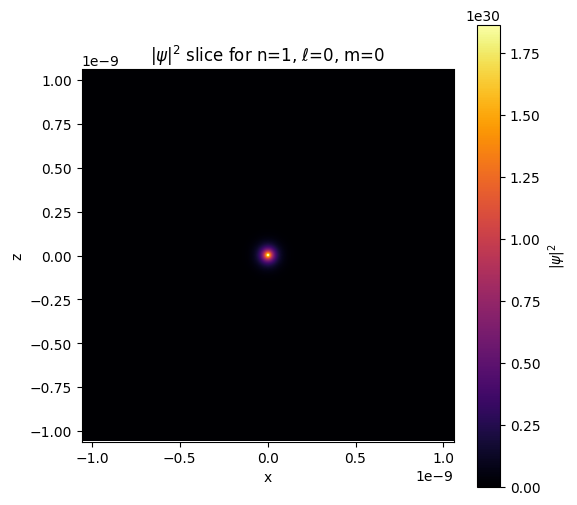

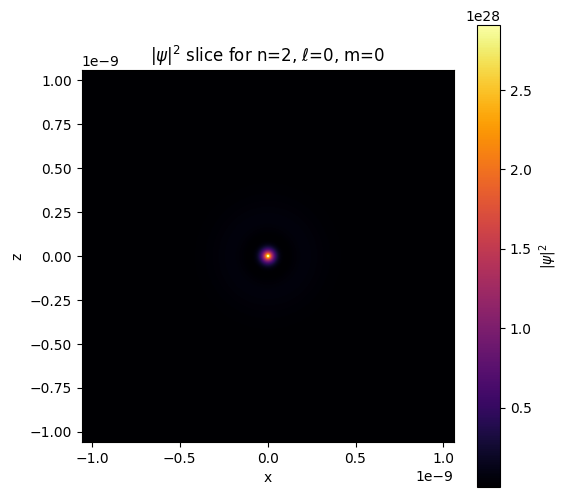

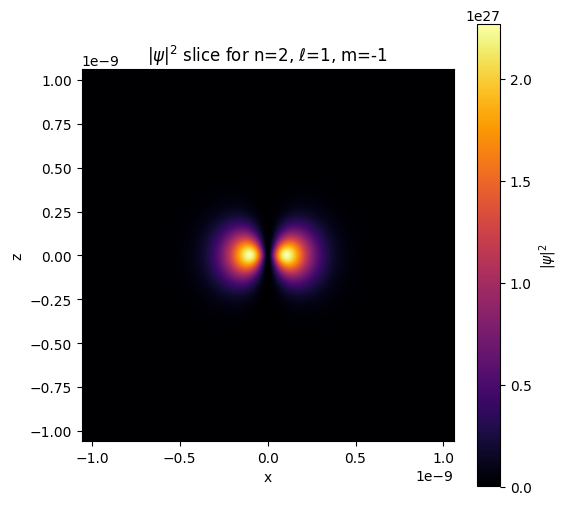

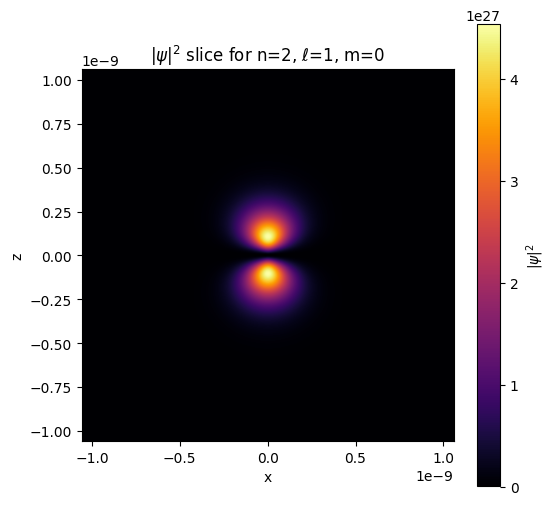

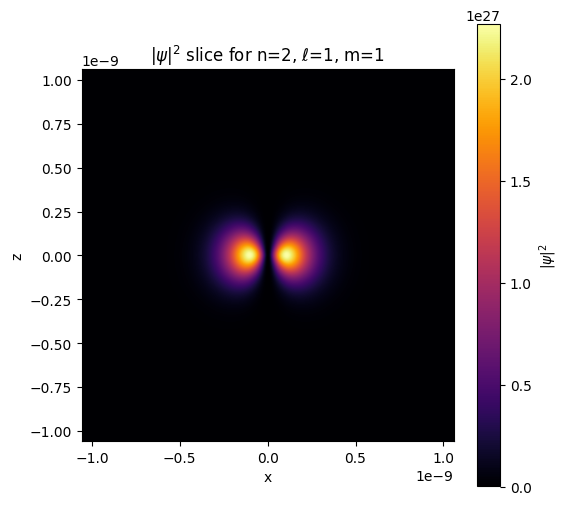

...

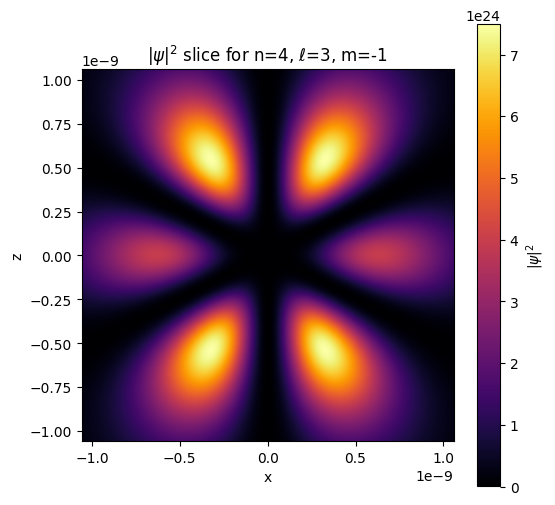

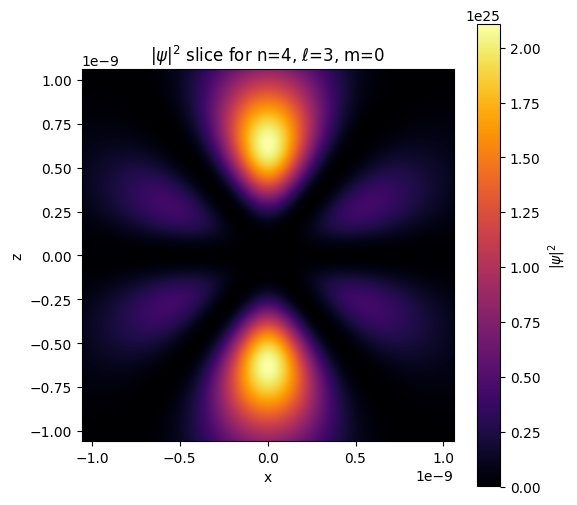

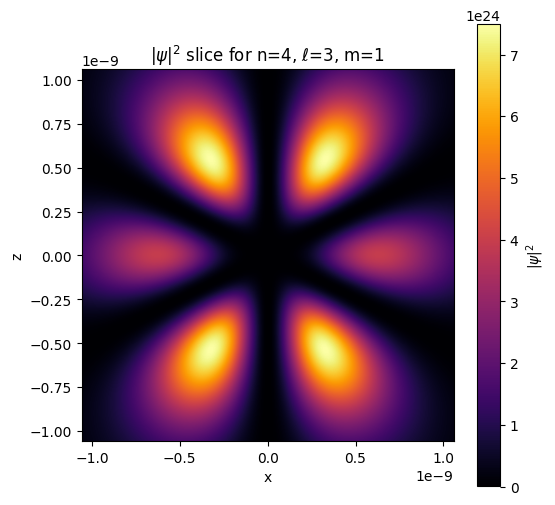

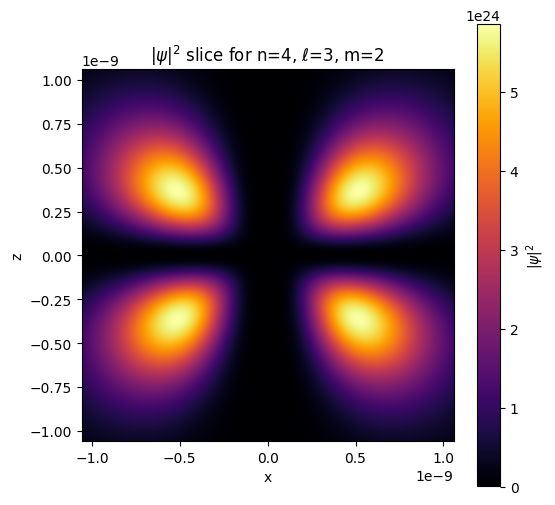

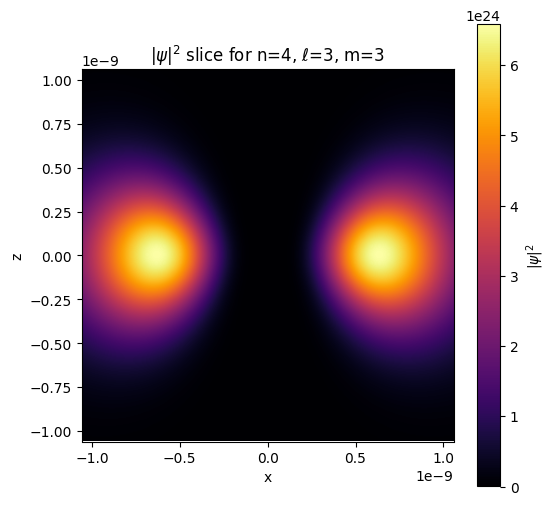

In [21]:
for n in range(1, 5):
    for l in range(0, n):
        for m in range(-l, l + 1):
            plot_slice(n,l,m)

In [13]:
def plot_orbital_3d(n, l, m, Rmax=15*a0, N=60, iso=0.2):
    # 3D grid
    x = np.linspace(-Rmax, Rmax, N)
    y = np.linspace(-Rmax, Rmax, N)
    z = np.linspace(-Rmax, Rmax, N)
    xx, yy, zz = np.meshgrid(x, y, z)

    r = np.sqrt(xx**2 + yy**2 + zz**2)
    theta = np.arccos(np.divide(zz, r, out=np.zeros_like(r), where=r!=0))
    phi = np.arctan2(yy, xx)

    psi = psi_nlm(n, l, m, r, theta, phi)
    val = np.abs(psi)**2

    fig = go.Figure(data=go.Isosurface(
        x=xx.flatten(),
        y=yy.flatten(),
        z=zz.flatten(),
        value=val.flatten(),
        isomin=np.max(val)*iso,
        isomax=np.max(val),
        opacity=0.5,
        surface_count=5,
        colorscale="Viridis"
    ))

    fig.update_layout(
        title=f"Hydrogen Orbital n={n}, l={l}, m={m}",
        scene=dict(aspectmode='data')
    )

    fig.show()

# Example: 2p orbital
plot_orbital_3d(2,1,0)

/var/folders/g1/x2bh3txd26n3xd5wj0ydblq40000gn/T/ipykernel_98580/3287716143.py:16: DeprecationWarning: `scipy.special.sph_harm` is deprecated as of SciPy 1.15.0 and will be removed in SciPy 1.17.0. Please use `scipy.special.sph_harm_y` instead.
  return sph_harm(m, l, phi, theta)


In [28]:
plot_orbital_3d(2, 0, 0, N=676)

KeyboardInterrupt: 

In [15]:
plot_orbital_3d(3, 2, 0) # explain where conical node com

/var/folders/g1/x2bh3txd26n3xd5wj0ydblq40000gn/T/ipykernel_98580/3287716143.py:16: DeprecationWarning:

`scipy.special.sph_harm` is deprecated as of SciPy 1.15.0 and will be removed in SciPy 1.17.0. Please use `scipy.special.sph_harm_y` instead.



In [27]:
plot_orbital_3d(5, 4, 1, Rmax = 50 * a0) # questions: do electrons even inhabit this orbital? velocity of electrons, stability of atoms, orbital occupancies

/var/folders/g1/x2bh3txd26n3xd5wj0ydblq40000gn/T/ipykernel_98580/3287716143.py:16: DeprecationWarning:

`scipy.special.sph_harm` is deprecated as of SciPy 1.15.0 and will be removed in SciPy 1.17.0. Please use `scipy.special.sph_harm_y` instead.



In [17]:
def plot_orbital_3d_spherical(n, l, m,
                              rmax=12*a0,
                              Nr=50, Ntheta=60, Nphi=60,
                              iso_ratio=0.05):
    """
    Direct spherical-grid orbital plot.
    Uses real wavefunctions so orbitals appear (px, py, etc.).
    """

    # Spherical grid
    r = np.linspace(0, rmax, Nr)
    theta = np.linspace(0, np.pi, Ntheta)
    phi = np.linspace(0, 2*np.pi, Nphi)

    rr, tt, pp = np.meshgrid(r, theta, phi, indexing="ij")

    # Complex hydrogenic ψ
    psi_complex = psi_nlm(n, l, m, rr, tt, pp)

    # Use real part of spherical harmonics = real orbitals
    psi = np.real(psi_complex)

    prob = psi**2

    # Convert to Cartesian
    xx = rr * np.sin(tt) * np.cos(pp)
    yy = rr * np.sin(tt) * np.sin(pp)
    zz = rr * np.cos(tt)

    # Determine isosurface threshold
    vmax = np.max(prob)
    vmin = iso_ratio * vmax

    # Build figure
    fig = go.Figure(data=go.Isosurface(
        x=xx.flatten(),
        y=yy.flatten(),
        z=zz.flatten(),
        value=prob.flatten(),
        isomin=vmin,
        isomax=vmax,
        surface_count=4,
        opacity=0.5,
        colorscale="Viridis",
        caps=dict(x_show=False, y_show=False, z_show=False)
    ))

    fig.update_layout(
        title=f"Hydrogen Orbital n={n}, l={l}, m={m}",
        scene=dict(aspectmode="data")
    )

    fig.show()


# TEST: 2p orbital
plot_orbital_3d_spherical(2, 1, 0)


/var/folders/g1/x2bh3txd26n3xd5wj0ydblq40000gn/T/ipykernel_98580/3287716143.py:16: DeprecationWarning:

`scipy.special.sph_harm` is deprecated as of SciPy 1.15.0 and will be removed in SciPy 1.17.0. Please use `scipy.special.sph_harm_y` instead.

